# Functions for cv2 to image


In [48]:
import numpy as np
import pandas as pd
from fpdf import FPDF
from PIL import Image as pili, ImageDraw as pild, ImageFont as pilf, ImageOps as piliops

TINT_COLOR = (0, 0, 0)  # Black
OPACITY = int(255 * 1)
FONT = pilf.truetype("Nirmala.ttf", 24) # Font
IMG_BASE_WIDTH = 600
IMG_NUMBERS = 47

#converting from image to cv2
def convert_from_cv2_to_image(img: np.ndarray) -> pili:
    return Image.fromarray(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    #return pili.fromarray(img)

#converting from cv2 to image
def convert_from_image_to_cv2(img: pili) -> np.ndarray:
    return cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
    #return np.asarray(img)


# Resizing the image

In [49]:
import cv2 
def imgcompress_mem(path_in, k):
    img = cv2.imread(path_in, cv2.IMREAD_UNCHANGED)

    # set the ratio of resized image
    width = int((img.shape[1])/k)
    height = int((img.shape[0])/k)

    # resize the image by resize() function of openCV library
    return cv2.resize(img, (width, height), interpolation=cv2.INTER_AREA)

# Function to cartoonize and add text

In [50]:
# Controls blur amount and line size and number of text lines. No bold font!
from PIL import Image 
def cartoonizeblt_mem_nb(path_in, k, blur, line, text, nlines=1, font='Nirmala'):
    
    print(path_in)
    imgc = imgcompress_mem(path_in, k)

    line_size = line
    blur_value = blur
    gray = cv2.cvtColor(imgc, cv2.COLOR_BGR2GRAY)
    gray_blur = cv2.medianBlur(gray, blur_value)
    bigedges = cv2.adaptiveThreshold(gray_blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, line_size, blur_value)
    bigedges_pil = cv2.cvtColor(bigedges, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

    toon = cv2.bitwise_and(imgc, imgc, mask=bigedges)
    if 0 == len(text):
        return toon
    
    print('Using font ' + font + '...')
    myfont = (
        pilf.truetype("Fonts/ITCKRIST.TTF", 
            24 if k == 16 else 18 if k == 14 else 18 if k == 12 else 20 if k == 8 else 82) if font=='ITCKRIST'
        else
            pilf.truetype("Fonts/Nirmala.TTF", 
                24 if k == 16 else 18 if k == 14 else 18 if k == 12 else 20 if k == 8 else 9) if font=='Nirmala'
        else
            pilf.truetype('Fonts/' + font + ".ttf", 24 if k == 16 else 18 if k == 14 else 18 if k == 12 else 20 if k == 8 else 8)
    )


    cblimg_pil = Image.fromarray(cv2.cvtColor(toon, cv2.COLOR_BGR2RGBA))

    overlay = pili.new('RGBA', cblimg_pil.size, TINT_COLOR+(0,))
    draw = pild.Draw(overlay)
    #_, h = FONT.getsize(text)
    _, h = myfont.getsize(text)
    num_lines = nlines
    x, y = 0, cblimg_pil.height - (num_lines)*h-10
    draw.rectangle((x, y, x + cblimg_pil.width, y + (num_lines)*h+10), fill=TINT_COLOR+(OPACITY,))
    if k == 1:
        draw.text((x+10, y), text, fill=(248,248,248), font=myfont) #, stroke_width=1)
    elif k < 8:
        draw.text((x+10, y), text, fill=(248,248,248), font=myfont)
    else:
        draw.text((x+0, y), text, fill=(248,248,248), font=myfont) #, stroke_width=1)

    cblimg_pil = pili.alpha_composite(cblimg_pil, overlay)
    cblimg_pil = cblimg_pil.convert("RGB")

    return convert_from_image_to_cv2(cblimg_pil)


# Adding border, resizing the images and creating a horizontal strip
The function simple_row() is using  function cartoonizeblt_mem_nb() to cartoonize the images and is being resized later with boders added to the images and stiched horizontally

In [51]:
import numpy as np
import pandas as pd
from fpdf import FPDF
from PIL import Image as pili, ImageDraw as pild, ImageFont as pilf, ImageOps as piliops

def simple_row(folder, list_im, list_opt, list_txt, list_nlines, font='Nirmala'):
    
    # cartoonize them in memory with text
    cimgs = [ cartoonizeblt_mem_nb(folder + '/' + i + '.jpeg', 10, 1, 3, k, nlines=n, font=font)
              for i,j,k,n in zip(list_im, list_opt, list_txt, list_nlines) ]
    
    # resize
    heighto = int(cimgs[0].shape[0])
    widtho = int(cimgs[0].shape[1])
    # heighto / widtho = height / width ==> height = heighto / widtho * width
    width = 245
    height = int(heighto / widtho * width)
    cimgs_dim = (width, height)
    cimgsr = [ cv2.resize(cimgs[i], cimgs_dim, interpolation = cv2.INTER_AREA) for i in range(4)]

    # add borders
    black = [0,0,0]
    bcimgs = [ cv2.copyMakeBorder(i, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=black) for i in cimgsr ]

    # stack them horizontally
    return np.concatenate([ bcimgs[i] for i in range(0,len(list_im)) ], axis=1)

Function returnfilname() is used for returning the images and returndialogues is used for returning the dialogues

In [52]:
def returnfilename(start,stop,df):
    if start>stop:
        return
    return ['d'+ str(i) for i in range(start,stop+1)]

def returndialogues(start,df):
    
    stop=len(df)
    if stop<start:
        return
    return [df[i] + '\n' + df[i+1] for i in range(start,stop,2)][:8]

Function generateimages() is using returnfilename() and returndialogues() which takes the folder of images as input, 'df' data frame, 'savedfolder' the folder in which the edited images are saved and 'lines' number of lines required for the dialogues on the strip

In [53]:
# generates images four at a time with text on them using the above functions

# folder: takes in filepath where the pictures are named in order of dialogues
# df: dataframe to iterate through
# savefolder: filepath that the pictures are saved in
# lines: number of text lines needed in the picture

def generateimages(folder,df,savefolder,lines):
    for i in range(0,len(df),4):
        
        if returndialogues(i*2,df)==':\n:':
            
            lines=1
        
        #print(returndialogues(i*2,df))
        print(i)
    
    
        rows4 = simple_row (                       
        folder, 
        returnfilename(i+1,i+4,df),                    # returns 4 files' names at a time
        ['pencil', 'pencil', 'buildings', 'buildings'],
        returndialogues(i*2,df) ,                   # returns 2 dialogues at a time starting from index i*2
        [lines, lines, lines, lines]
        )
        rows4_pil = cv2.cvtColor(rows4, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
        display(Image.fromarray(rows4_pil))
        Image.fromarray(rows4_pil).save(savefolder+"s"+str(i)+".jpeg") # saves folder
        rows4_pil.shape
        if i>=16: break # breaks loop to make sure only 20 pictures are returned at a time
        
        

# Reading dialog file with Pandas in English

In [54]:
import pandas as pd

# reading data for scene 1
data = pd.read_csv('datascience_assignment5/DataScience/Assignment5/Scene1/scene1.csv')
data.head(10)

,Scene 1
0,.
1,.
2,.
3,.
4,.
5,.
6,.
7,.
8,.
9,.


0
datascience_assignment5/DataScience/Assignment5/Scene1/d1.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d2.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d3.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d4.jpeg
Using font Nirmala...


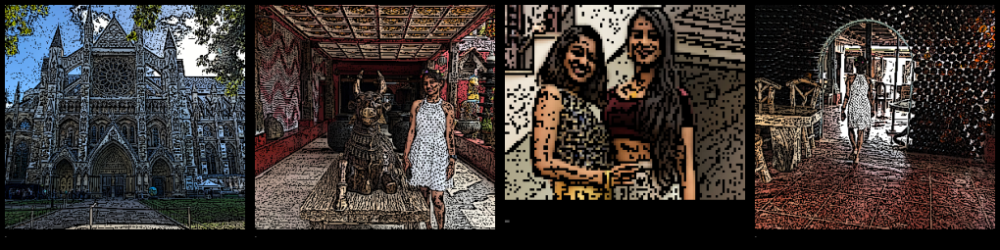

4
datascience_assignment5/DataScience/Assignment5/Scene1/d5.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d6.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d7.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d8.jpeg
Using font Nirmala...


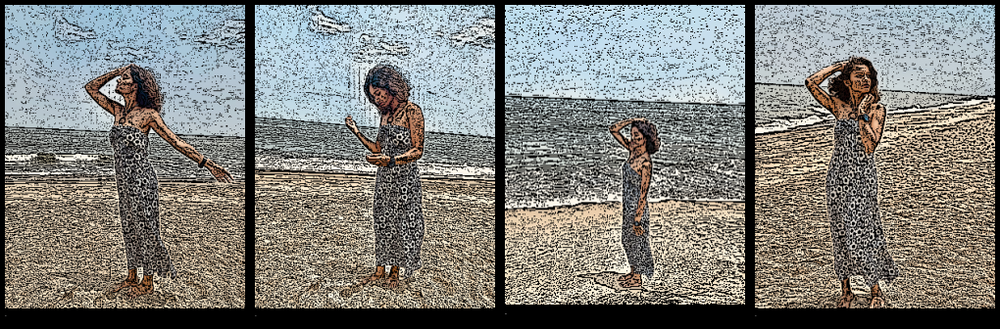

8
datascience_assignment5/DataScience/Assignment5/Scene1/d9.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d10.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d11.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d12.jpeg
Using font Nirmala...


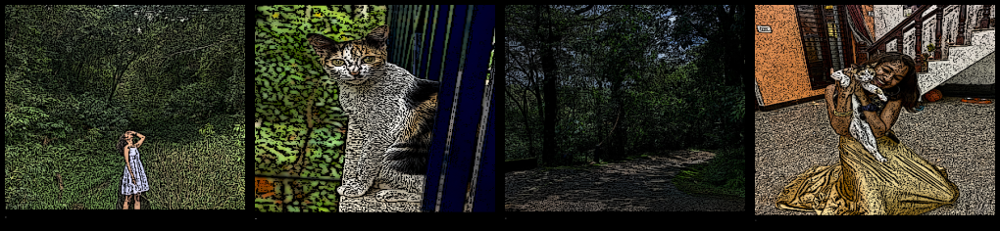

12
datascience_assignment5/DataScience/Assignment5/Scene1/d13.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d14.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d15.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d16.jpeg
Using font Nirmala...


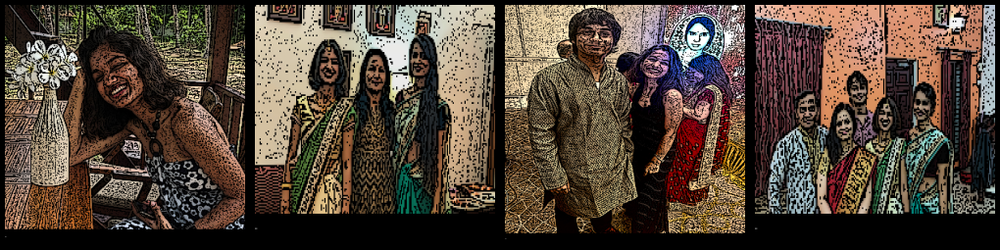

16
datascience_assignment5/DataScience/Assignment5/Scene1/d17.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d18.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d19.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene1/d20.jpeg
Using font Nirmala...


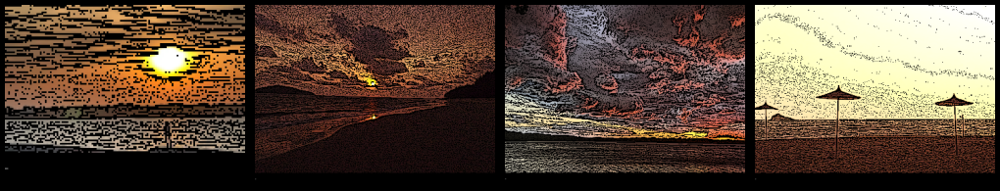

In [55]:
# generating images for scene 1

df = [d for d in data["Scene 1"]]
generateimages('datascience_assignment5/DataScience/Assignment5/Scene1', df, 'datascience_assignment5/DataScience/Assignment5/Scene1/Scene1Strips/',1)

In [69]:
# scene 1 pdf generation


# places items generated in the previous cells in order. Text in pdf for narration of story placed accordingly

from PIL import Image
from fpdf import FPDF


width = 2580
height = 3508
pdf = FPDF(unit = "pt", format = [width, height])
pdf.add_page()
pdf.add_font("timesnewroman", style="", fname="datascience_assignment5/Fonts/timesnewroman.ttf", uni=True)
pdf.set_font("timesnewroman","",35)
pdf.set_fill_color(r=245,g=245,b=220)
pdf.set_title("Medusa: How it should have ended")

pdf.multi_cell(w=2580,h=50,txt="Medusa: How it should have ended",border=1,align='C',fill=2)
pdf.multi_cell(w=2580,h=50,txt="""Once upon a time there lived a girl, soft and graceful. Her name was Medusa. She was one of the daughters of the sea deities Phorcys and Ceto and she lived close to the Hesperides in the Western Ocean near Sarpedon. As was common for the time, Medusa committed to devoting her life to the temple of Athena where she was a priestess.""",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene1/Scene1Strips/s0.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=55,txt="""When she was relieved of her priestly duties, she would often linger around the ocean. She would stare into the horizon for hours, letting her mind wander around love and sacrifice secretly craving it even if she knew it would not be forgiven.""",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene1/Scene1Strips/s4.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=55,txt="""When the moon and the wind would not allow her to be near the sea, she would loiter around lush forests. Her cat, Astro was a lovable creature who would go about these adventures with her. """,border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene1/Scene1Strips/s8.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=55,txt="""She would seldom be with her family but on an occasion that she was, she cherished their company.""",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene1/Scene1Strips/s12.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=55,txt="""While she was determined to stay celibate and honour Athena, she could not stop thinking about love and all the poems written about it. She made a promise to herself that she would only let her mind wander around the sea. Little did she know that the sea would change the entire course of her life. """,border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene1/Scene1Strips/s16.jpeg",None,None,2580,575)




print("done!")

done!


In [70]:
# Reading data for scene 2

data = pd.read_csv('datascience_assignment5/DataScience/Assignment5/Scene2/scene2.csv')
data.head(10)

,Scene 2
0,"One day, on a fine sunny morning a man walked ..."
1,Man: It's a shame that a woman such as you \nh...
2,Medusa: The temple is not expecting visitors \...
3,Man: I'm looking at you. \nWhat other purpose ...
4,Medusa: Do you have no shame \nin courting a p...
5,Man: I have watched you at the south shore \ni...
6,Medusa: Who are you and \nwhy do you spy?
7,Man: I am not here to hurt you. \nI am simply ...
8,Medusa: You have no business in the matters \n...
9,Medusa wanted the man to leave but there was s...


0
datascience_assignment5/DataScience/Assignment5/Scene2/d1.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d2.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d3.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d4.jpeg
Using font Nirmala...


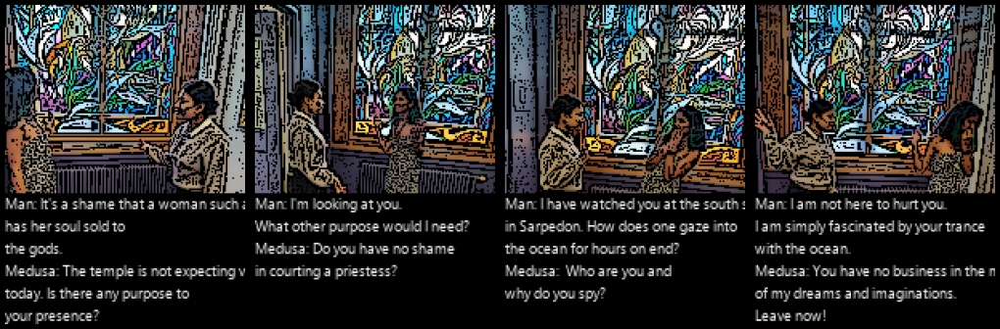

4
datascience_assignment5/DataScience/Assignment5/Scene2/d5.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d6.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d7.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d8.jpeg
Using font Nirmala...


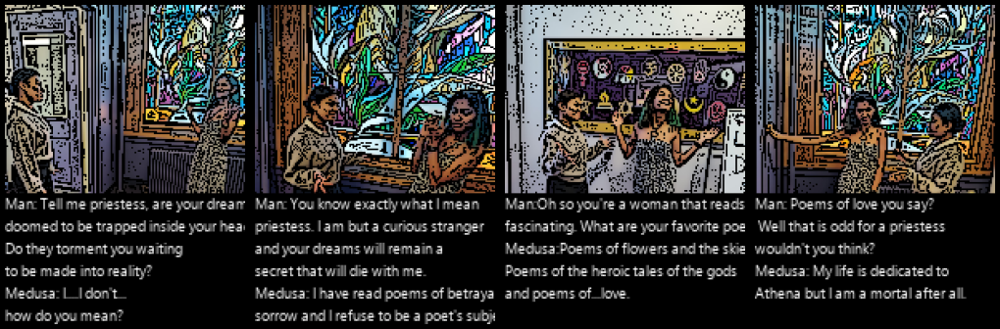

8
datascience_assignment5/DataScience/Assignment5/Scene2/d9.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d10.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d11.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d12.jpeg
Using font Nirmala...


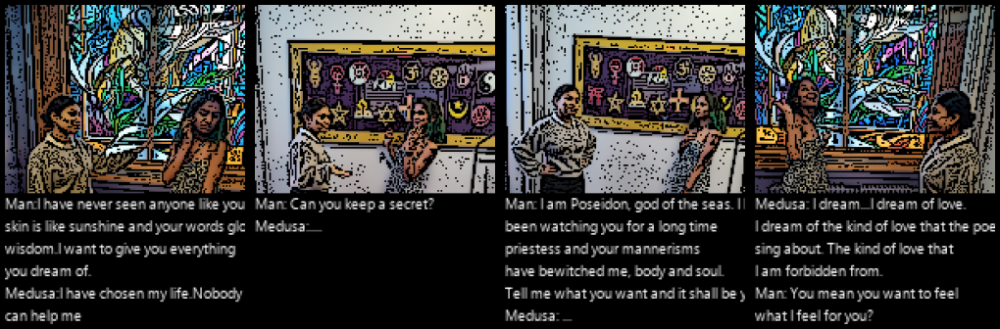

12
datascience_assignment5/DataScience/Assignment5/Scene2/d13.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d14.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d15.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d16.jpeg
Using font Nirmala...


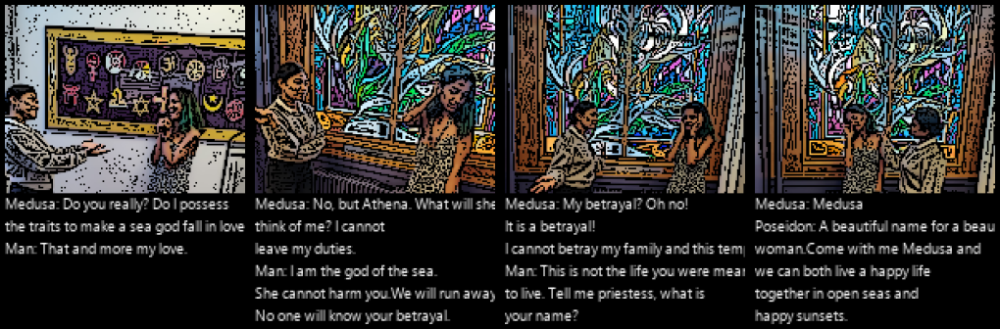

16
datascience_assignment5/DataScience/Assignment5/Scene2/d17.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d18.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d19.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene2/d20.jpeg
Using font Nirmala...


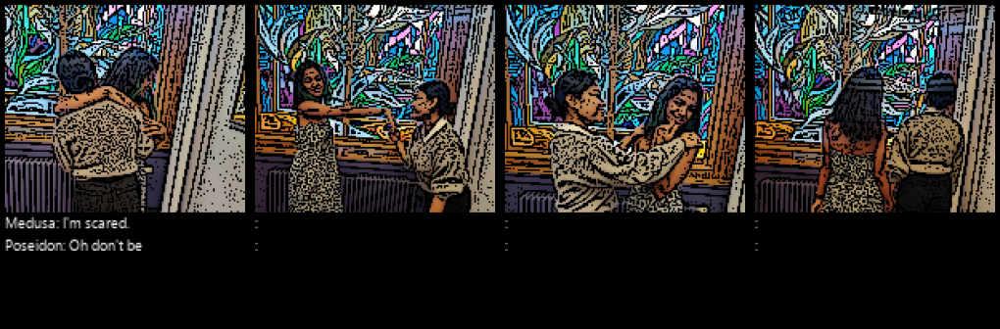

In [71]:
# scene 2 image generation

df = [d for d in data["Scene 2"] if ':' in d] # reading only dialogues from csv and leaving out story narration
generateimages('datascience_assignment5/DataScience/Assignment5/Scene2', df, 'datascience_assignment5/DataScience/Assignment5/Scene2/Scene2Strips/',6)

In [72]:
#scene 2 page generation


pdf.add_page()
pdf.set_font("timesnewroman","",35)
pdf.set_fill_color(r=245,g=245,b=220)

pdf.multi_cell(w=2580,h=50,txt="""One day, on a fine sunny morning a man walked into the temple just when Medusa was getting finished with her priestly duties. He was a tall man who was the quiet kind of handsome. He approached Medusa with curious delight in his eyes.""",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene2/Scene2Strips/s0.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=55,txt="""Medusa wanted the man to leave but there was something familiar about him. It was almost as if she felt safe around him even though his actions proved he could be dangerous.""",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene2/Scene2Strips/s4.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=55,txt="""Medusa knew she was walking on dangerous territory with her admission but she was already lost in this strange man's fascination with her. She was failing at keeping the promise she made to herself.""",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene2/Scene2Strips/s8.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=55,txt="""Medusa instantly knew why she felt safe with the man. He was the sea and she had fallen in love with the sea already. To have bewitched the sea itself was a possibility she could not imagine and yet, it was a reality that was happening.""",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene2/Scene2Strips/s12.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=55,txt="""The man had Medusa's heart. She wanted to leave but she was afraid of the consequences that would come. She was however convinced that Poseidon would be able to save her from the prison that was her life and the consequences of leaving.""",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene2/Scene2Strips/s16.jpeg",None,None,2580,575)


print("done!")

done!


In [73]:
#reading data for scene 3

data = pd.read_csv('datascience_assignment5/DataScience/Assignment5/Scene3/scene3.csv')
data.head(10)


,Scene 3:
0,:
1,:
2,:
3,:
4,Athena: Who dares taint the walls of these \r\...
5,Poseidon: Athena?
6,Athena: Leave this temple at once! How \r\ndar...
7,Poseidon: Watch your tone when you talk \r\nto...
8,Medusa was truly scared. She did not anticipat...
9,Athena: And you!? Are you not a priestess? \r\...


0
datascience_assignment5/DataScience/Assignment5/Scene3/d1.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d2.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d3.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d4.jpeg
Using font Nirmala...


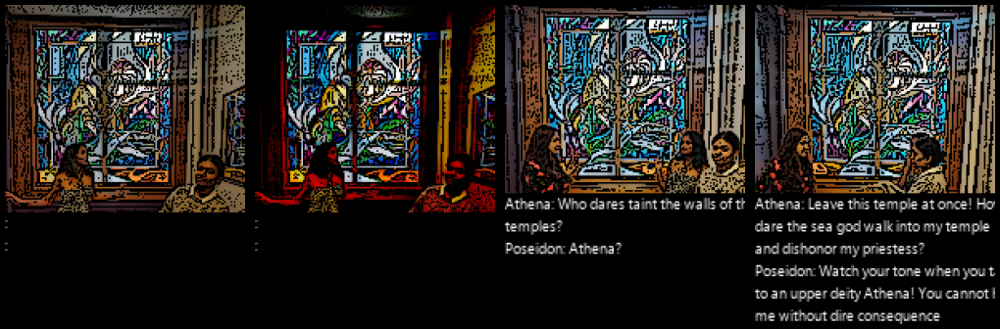

4
datascience_assignment5/DataScience/Assignment5/Scene3/d5.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d6.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d7.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d8.jpeg
Using font Nirmala...


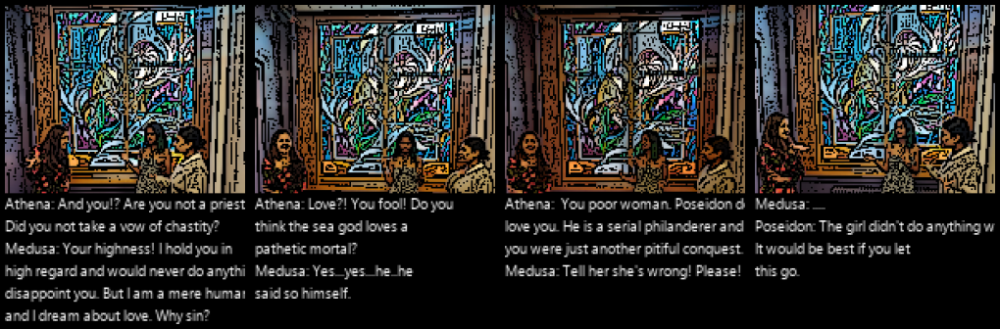

8
datascience_assignment5/DataScience/Assignment5/Scene3/d9.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d10.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d11.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d12.jpeg
Using font Nirmala...


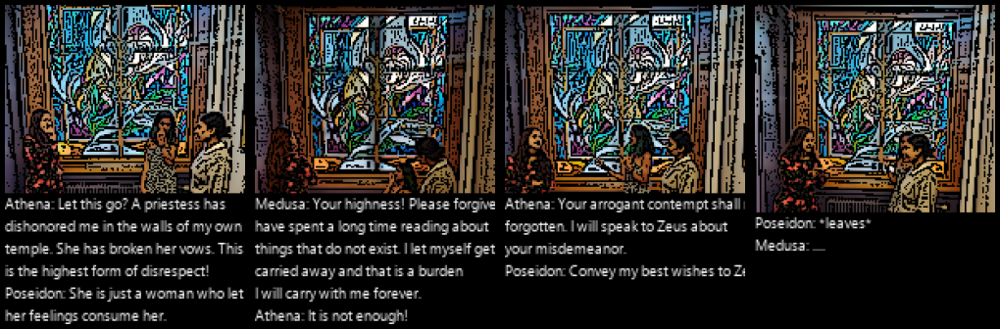

12
datascience_assignment5/DataScience/Assignment5/Scene3/d13.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d14.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d15.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d16.jpeg
Using font Nirmala...


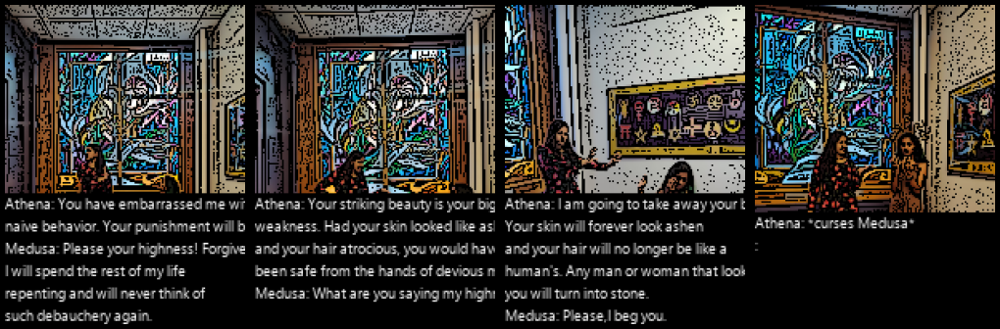

16
datascience_assignment5/DataScience/Assignment5/Scene3/d17.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d18.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d19.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene3/d20.jpeg
Using font Nirmala...


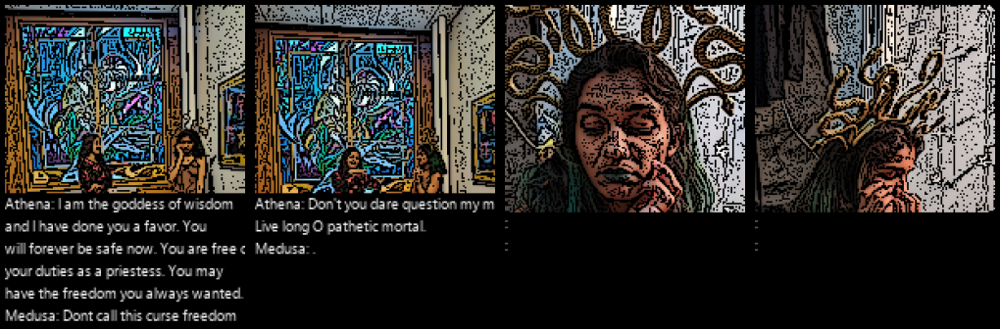

In [74]:
# scene 3 image generation
df = [d for d in data["Scene 3:"] if ':' in d] # reading only dialogues
generateimages('datascience_assignment5/DataScience/Assignment5/Scene3', df, 'datascience_assignment5/DataScience/Assignment5/Scene3/Scene3Strips/',6)


In [75]:
#scene 3 page generation


pdf.add_page()
pdf.set_font("timesnewroman","",35)
pdf.set_fill_color(r=245,g=245,b=220)



pdf.image("datascience_assignment5/DataScience/Assignment5/Scene3/Scene3Strips/s0.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=55,txt="Medusa was truly scared. She did not anticipate repurcussions to come so immediately. The only thing she could do was trust Poseidons word and hope that he could save her",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene3/Scene3Strips/s4.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=55,txt=u"Medusa could not believe what she was hearing. She had fallen for Poseidon inspite of knowing his history. She was truly fooled and she had no other choice but to face the wrath of Athena",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene3/Scene3Strips/s8.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=55,txt=u"Medusa had no hopes left. All she could do was beg Athena for mercy.",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene3/Scene3Strips/s12.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=55,txt=u"The worst had happened. Medusa would have to live with this monstrosity until the day she died.",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene3/Scene3Strips/s16.jpeg",None,None,2580,575)



print("done!")

done!


In [76]:
# Reading data for scene 4

data = pd.read_csv('datascience_assignment5/DataScience/Assignment5/Scene4/scene4.csv')
data.head(10)

,Scene 4:
0,Medusa couldn't save her loved ones from her d...
1,:
2,:
3,:
4,:
5,:
6,:
7,:
8,:
9,The people in the kingdom grew scared of Medus...


0
datascience_assignment5/DataScience/Assignment5/Scene4/d1.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d2.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d3.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d4.jpeg
Using font Nirmala...


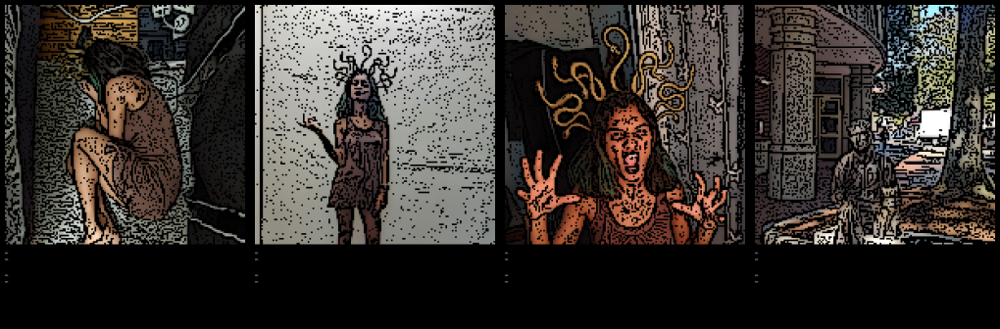

4
datascience_assignment5/DataScience/Assignment5/Scene4/d5.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d6.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d7.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d8.jpeg
Using font Nirmala...


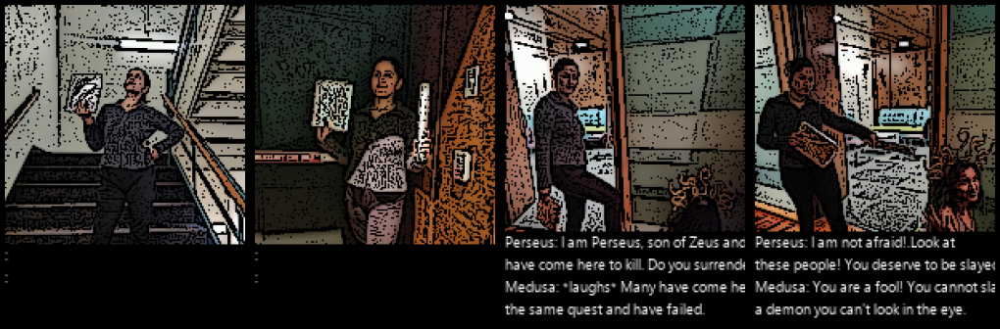

8
datascience_assignment5/DataScience/Assignment5/Scene4/d9.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d10.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d11.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d12.jpeg
Using font Nirmala...


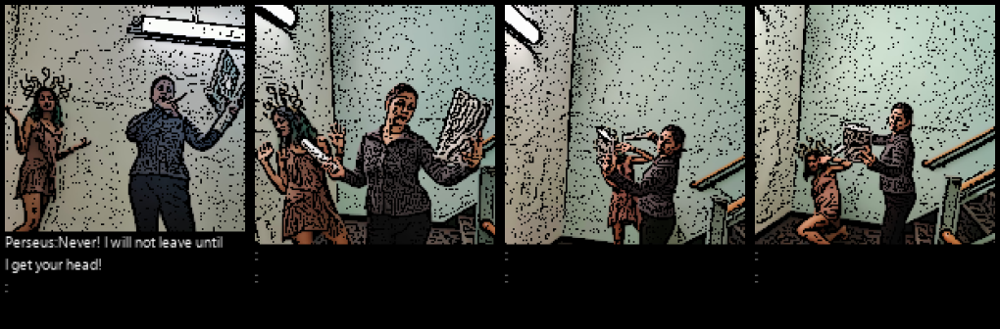

12
datascience_assignment5/DataScience/Assignment5/Scene4/d13.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d14.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d15.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d16.jpeg
Using font Nirmala...


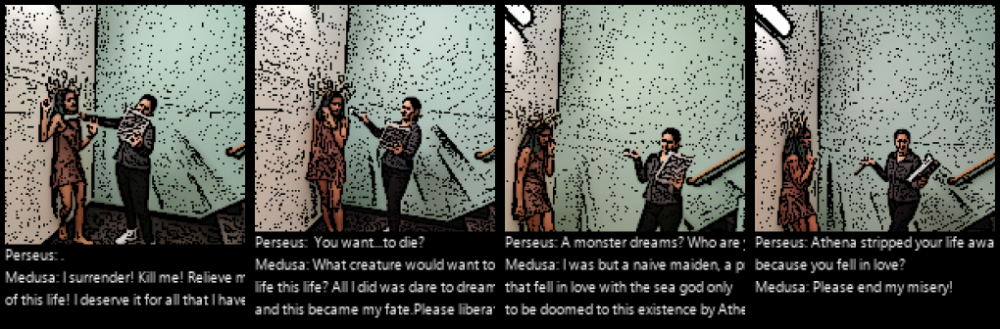

16
datascience_assignment5/DataScience/Assignment5/Scene4/d17.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d18.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d19.jpeg
Using font Nirmala...
datascience_assignment5/DataScience/Assignment5/Scene4/d20.jpeg
Using font Nirmala...


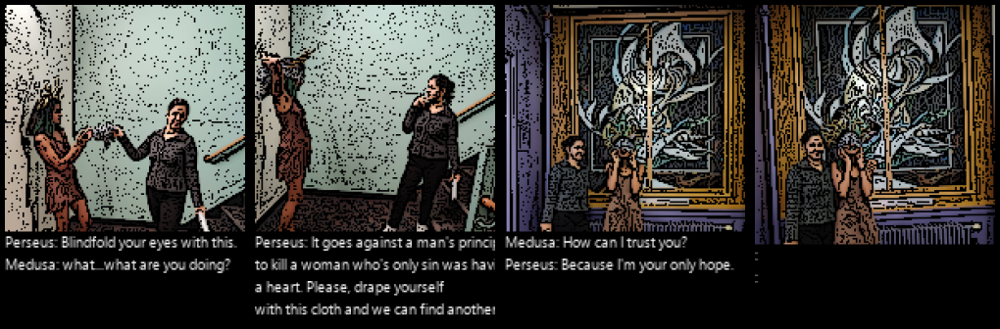

In [77]:
# scene 4 image generation 

df = [d for d in data["Scene 4:"] if ':' in d]
generateimages('datascience_assignment5/DataScience/Assignment5/Scene4', df, 'datascience_assignment5/DataScience/Assignment5/Scene4/Scene4Strips/',4)


In [81]:
#scene 4 page generation

pdf.add_page()
pdf.add_font("timesnewroman", style="", fname="datascience_assignment5/Fonts/timesnewroman.ttf", uni=True)
pdf.set_font("timesnewroman","",35)
#pdf.set_doc_option('core_fonts_encoding', 'utf-8')
pdf.set_fill_color(r=245,g=245,b=220)


pdf.multi_cell(w=2580,h=50,txt="Medusa couldn’t save her loved ones from her dangerous gaze. She lost everybody she ever loved and was doomed to live a heartless life. She eventually became a bitter woman and would turn anybody that tried to speak to her into stone. She lived in a dark cave with all the statues of the people she turned into stone.",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene4/Scene4Strips/s0.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=50,txt="The people in the kingdom grew scared of Medusa.The king sent many of his men to defeat Medusa but they never came back from the cave. In his last attempt, the king sent Perseus, a demigod who was the son of Zeus. Perseus was known for his bravery and intelligence. He was the only one who could be strong enough to defeat Medusa. On a rainy day in August, Perseus started off on his quest with a shield and a sword. After a long walk, he finally found her sleeping away from him close to the statues.",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene4/Scene4Strips/s4.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=50,txt="Medusa was right. Perseus would not be able to behead her without looking at her. He would never be a coward and go back to the kingdom so his only option was to die trying. Perseus almost accepted his fate when suddenly he discovered that he could see her reflection in his shield!",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene4/Scene4Strips/s8.jpeg",None,None,2580,575)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene4/Scene4Strips/s12.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=50,txt="Perseus was sent to kill a monster but in its place, he found a damsel in distress. How could he kill her now after knowing the monster was just a woman with a heart? ",border=1,align='L',fill=1)

pdf.image("datascience_assignment5/DataScience/Assignment5/Scene4/Scene4Strips/s16.jpeg",None,None,2580,575)

pdf.multi_cell(w=2580,h=50,txt="Perseus took Medusa back to the kingdom and explained to the king and the townsfolk that Medusa was merely a misunderstood woman. While it took Medusa a significant amount of time to win their trust back, they succeeded in looking past her snake hair and ashen face.",border=1,align='L',fill=1)

pdf.output("final_english.pdf", "F")
print("done!")

FileNotFoundError: [Errno 2] No such file or directory: '/Users/user/Library/Fonts/timesnewroman.ttf'

# Reading dialog file with Pandas in Hindi

In [30]:
import pandas as pd

# reading data for scene 1
data = pd.read_csv('Scene1/Scene1H.csv')
data.head(10)

,Scene 1
0,.
1,.
2,.
3,.
4,.
5,.
6,.
7,.
8,.
9,.


0
Scene1/d1.jpeg
Using font Nirmala...
Scene1/d2.jpeg
Using font Nirmala...
Scene1/d3.jpeg
Using font Nirmala...
Scene1/d4.jpeg
Using font Nirmala...


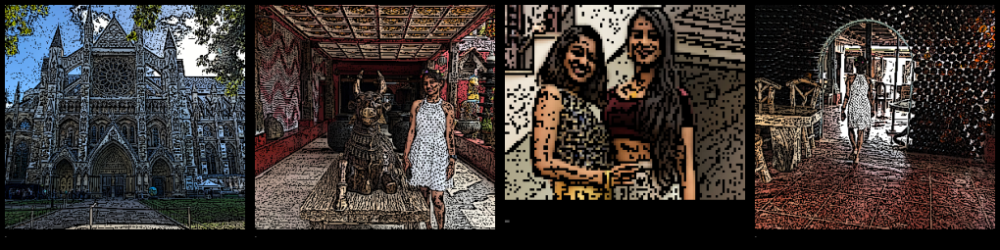

4
Scene1/d5.jpeg
Using font Nirmala...
Scene1/d6.jpeg
Using font Nirmala...
Scene1/d7.jpeg
Using font Nirmala...
Scene1/d8.jpeg
Using font Nirmala...


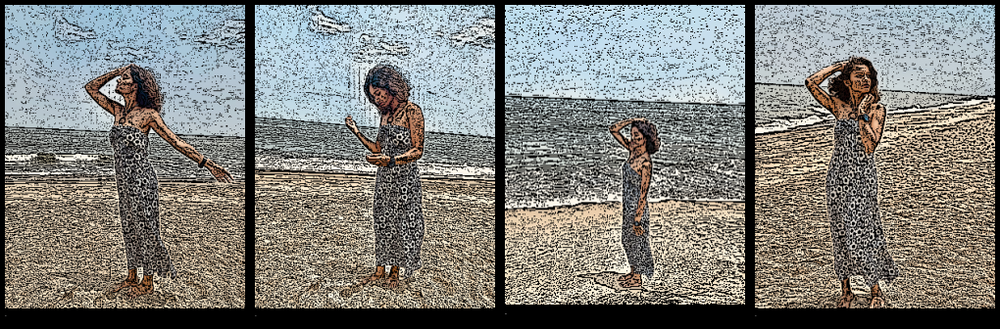

8
Scene1/d9.jpeg
Using font Nirmala...
Scene1/d10.jpeg
Using font Nirmala...
Scene1/d11.jpeg
Using font Nirmala...
Scene1/d12.jpeg
Using font Nirmala...


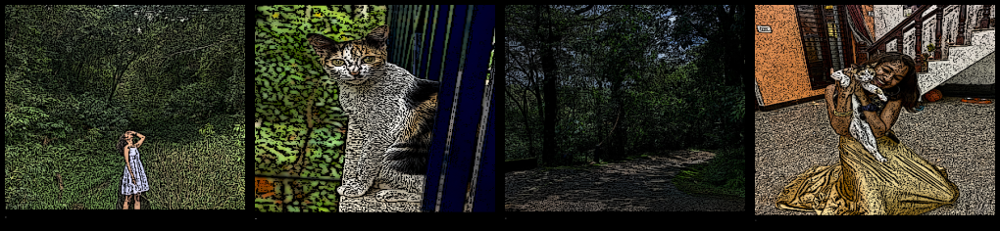

12
Scene1/d13.jpeg
Using font Nirmala...
Scene1/d14.jpeg
Using font Nirmala...
Scene1/d15.jpeg
Using font Nirmala...
Scene1/d16.jpeg
Using font Nirmala...


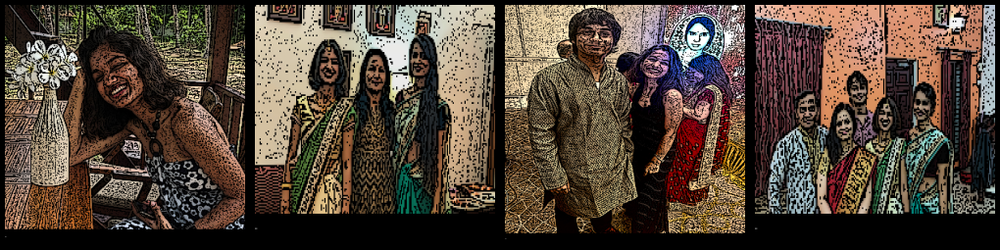

16
Scene1/d17.jpeg
Using font Nirmala...
Scene1/d18.jpeg
Using font Nirmala...
Scene1/d19.jpeg
Using font Nirmala...
Scene1/d20.jpeg
Using font Nirmala...


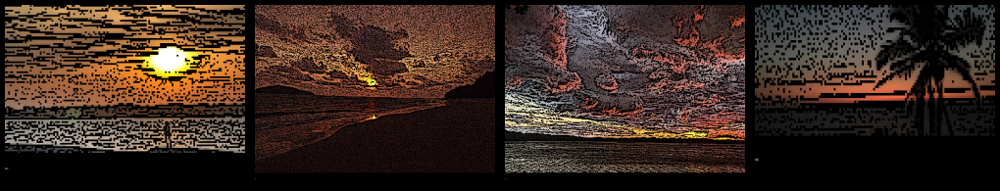

In [32]:
# generating images for scene 1

df = [d for d in data["Scene 1"]]
generateimages('Scene1', df, 'Scene1/Scene1Strips/',1)

# Unicode Fonts
Using Nirmala.ttf font for Hindi language and saving the strips of the narration part

In [33]:
#Unicode

from PIL import Image, ImageDraw, ImageFont, ImageFilter

#configuration
font_size=36
width=6000
height=100
back_ground_color=(255,255,255)
font_size=36
font_color=(0,0,0)
unicode_text = [u"एक बार की बात है, एक कोमल और सुंदर लड़की रहती थी। उसका नाम मेडुसा था। वह समुद्री देवताओं फोर्किस और सेटो की बेटियों में से एक थी और वह सरपीडन के पास पश्चिमी महासागर में हेस्परिड्स के करीब रहती थी। जैसा कि उस समय के लिए सामान्य था, मेडुसा ने अपना जीवन एथेना के मंदिर में समर्पित करने के लिए प्रतिबद्ध किया जहां वह एक पुजारी थी।",
                u"जब वह अपने पुरोहित कर्तव्यों से मुक्त हो जाती थी, तो वह अक्सर समुद्र के चारों ओर घूमती रहती थी। वह घंटों तक क्षितिज में घूरती रहती, अपने मन को प्रेम के इर्द-गिर्द भटकने देती और गुप्त रूप से उसे तरसने के लिए बलिदान करती, भले ही वह जानती थी कि इसे माफ नहीं किया जाएगा।",
                u"जब चंद्रमा और हवा उसे समुद्र के पास नहीं रहने देती, तो वह हरे-भरे जंगलों में घूमती रहती। उसकी बिल्ली, एस्ट्रो एक प्यारा प्राणी था जो उसके साथ इन कारनामों के बारे में जाना।",
                u"वह शायद ही कभी अपने परिवार के साथ रहती थी, लेकिन एक अवसर पर, वह उनकी कंपनी को संजोती थी।",
                u"जबकि वह ब्रह्मचारी रहने और एथेना का सम्मान करने के लिए दृढ़ थी, वह प्यार और उसके बारे में लिखी गई सभी कविताओं के बारे में सोचना बंद नहीं कर सकी। उसने अपने आप से एक वादा किया कि वह केवल अपने मन को समुद्र के चारों ओर घूमने देगी। उसे क्या पता था कि समुद्र उसके पूरे जीवन को बदल देगा।"]

for i in range(0,5):
    im  =  Image.new ( "RGB", (width,height), back_ground_color )
    draw  =  ImageDraw.Draw ( im )
    unicode_font = ImageFont.truetype("Fonts/Nirmala.TTF", font_size)
    draw.text ( (10,10), unicode_text[i], font=unicode_font, fill=font_color )
    im.save("Scene1/hindi1_" + str(i+1) + ".jpg")


# Creating PDF for Page1

In [34]:
from PIL import Image
from fpdf import FPDF


width = 2580
height = 3508
pdf = FPDF(unit = "pt", format = [width, height])
pdf.add_page()
pdf.set_font("times","",35)
pdf.set_fill_color(r=245,g=245,b=220)
#cover = Image.open('toons/jungle-book/_104680082_junglebook.jpg')
#width, height = cover.size
#pdf = FPDF(unit = "pt", format = [width, height])


pdf.image("Scene1/hindi1_1.jpg",None,None,3000,100)
pdf.image("Scene1/Scene1Strips/s0.jpeg",None,None,2580,575)

pdf.image("Scene1/hindi1_2.jpg",None,None,3000,100)
pdf.image("Scene1/Scene1Strips/s4.jpeg",None,None,2580,575)

pdf.image("Scene1/hindi1_3.jpg",None,None,3000,100)
pdf.image("Scene1/Scene1Strips/s8.jpeg",None,None,2580,575)

pdf.image("Scene1/hindi1_4.jpg",None,None,3000,100)
pdf.image("Scene1/Scene1Strips/s12.jpeg",None,None,2580,575)

pdf.image("Scene1/hindi1_5.jpg",None,None,3000,100)
pdf.image("Scene1/Scene1Strips/s16.jpeg",None,None,2580,575)


print("done!")

done!


In [35]:
# Reading data for scene 2
import pandas as pd

data = pd.read_excel('Scene2/Scene2H.xlsx')
data.head(10)

,Scene 2
0,.
1,"एक दिन, एक अच्छी धूप वाली सुबह एक आदमी मंदिर म..."
2,.
3,\nपुरुष: यह शर्म की बात है कि आप जैसी महिला\nक...
4,\nमेडुसा: मंदिर आगंतुकों की उम्मीद नहीं कर \nर...
5,.
6,\nआदमी: मैं तुम्हें देख रहा हूँ।\nमुझे और क्या...
7,मेडुसा: क्या आपको कोई शर्म नहीं है\nएक पुजारी ...
8,.
9,आदमी: मैंने तुम्हें दक्षिण तट पर देखा है\nसर्प...


0
Scene2/d1.jpeg
Using font Nirmala...
Scene2/d2.jpeg
Using font Nirmala...
Scene2/d3.jpeg
Using font Nirmala...
Scene2/d4.jpeg
Using font Nirmala...


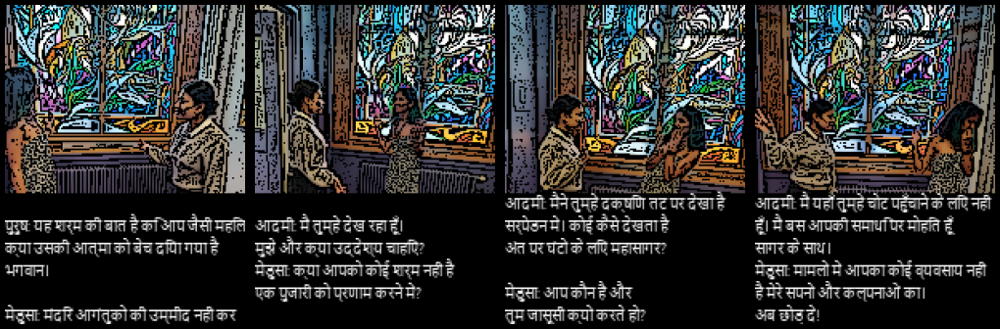

4
Scene2/d5.jpeg
Using font Nirmala...
Scene2/d6.jpeg
Using font Nirmala...
Scene2/d7.jpeg
Using font Nirmala...
Scene2/d8.jpeg
Using font Nirmala...


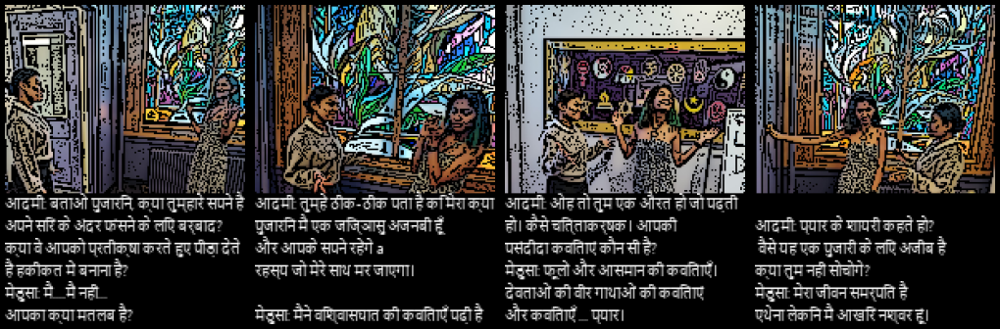

8
Scene2/d9.jpeg
Using font Nirmala...
Scene2/d10.jpeg
Using font Nirmala...
Scene2/d11.jpeg
Using font Nirmala...
Scene2/d12.jpeg
Using font Nirmala...


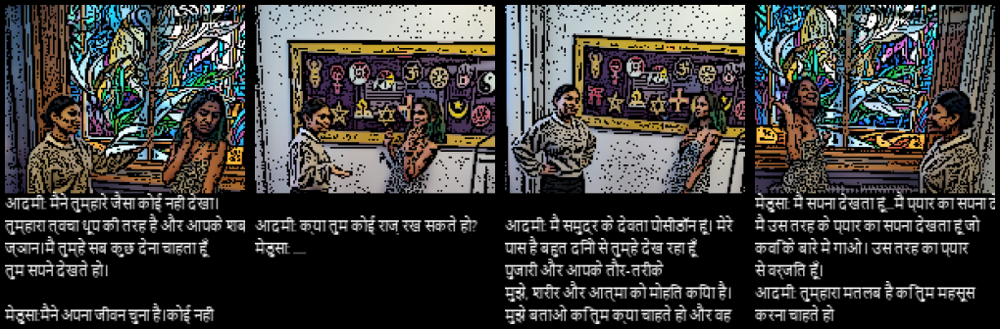

12
Scene2/d13.jpeg
Using font Nirmala...
Scene2/d14.jpeg
Using font Nirmala...
Scene2/d15.jpeg
Using font Nirmala...
Scene2/d16.jpeg
Using font Nirmala...


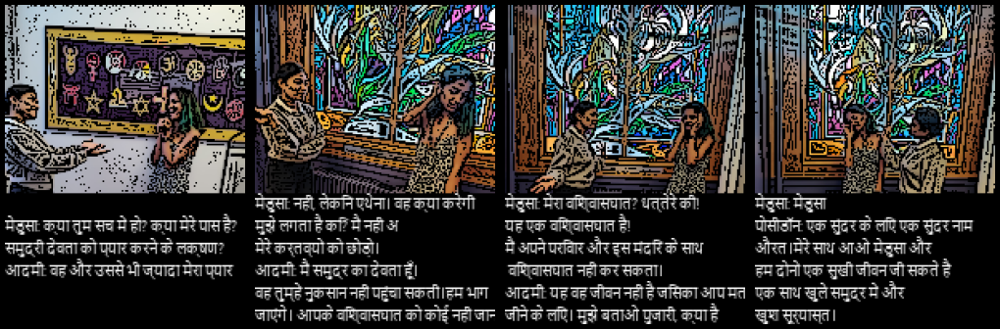

16
Scene2/d17.jpeg
Using font Nirmala...
Scene2/d18.jpeg
Using font Nirmala...
Scene2/d19.jpeg
Using font Nirmala...
Scene2/d20.jpeg
Using font Nirmala...


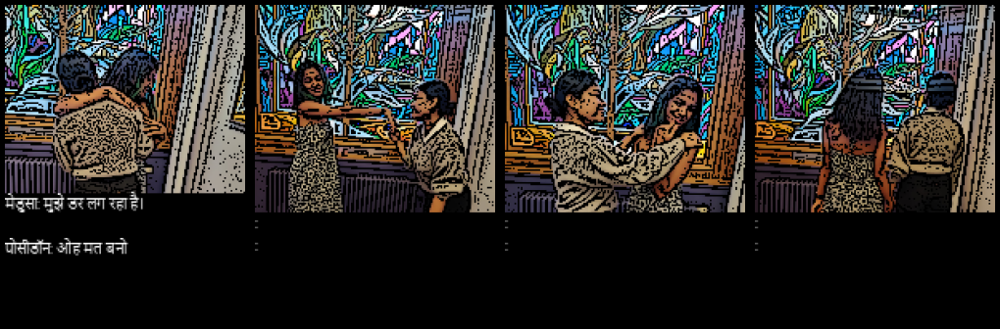

In [36]:
# scene 2 image generation

df = [d for d in data["Scene 2"] if ':' in d]
generateimages('Scene2', df, 'Scene2/Scene2Strips/',6)

In [37]:
#Unicode

from PIL import Image, ImageDraw, ImageFont, ImageFilter

#configuration
font_size=36
width=6000
height=100
back_ground_color=(255,255,255)
font_size=36
font_color=(0,0,0)
unicode_text = [u"एक दिन, एक सुहावनी धूप में, एक आदमी मंदिर में चला गया, जब मेडुसा अपने पुरोहित कर्तव्यों को पूरा कर रहा था। वह एक लंबा आदमी था जो शांत किस्म का हैंडसम था। वह अपनी आँखों में उत्सुकता के साथ मेडुसा के पास पहुँचा।",
                u"मेडुसा चाहता था कि वह आदमी चले जाए लेकिन उसके बारे में कुछ जाना-पहचाना था। यह लगभग वैसा ही था जैसे वह उसके आसपास सुरक्षित महसूस करती थी, भले ही उसकी हरकतें साबित कर दें कि वह खतरनाक हो सकता है।",
                u"मेडुसा जानती थी कि वह अपने प्रवेश के साथ खतरनाक क्षेत्र में चल रही है लेकिन वह पहले से ही इस अजीब आदमी के आकर्षण में खो गई थी। वह खुद से किए गए वादे को निभाने में विफल हो रही थी।",
                u"मेडुसा को तुरंत पता चल गया कि वह उस आदमी के साथ सुरक्षित क्यों महसूस करती है। वह समुद्र था और उसे समुद्र से पहले ही प्रेम हो गया था। समुद्र को मोहित करना एक ऐसी संभावना थी जिसकी वह कल्पना भी नहीं कर सकती थी और फिर भी, यह एक वास्तविकता थी जो हो रही थी।",
                u"उस आदमी के पास मेडुसा का दिल था। वह छोड़ना चाहती थी लेकिन उसे आने वाले परिणामों का डर था। हालांकि वह आश्वस्त थी कि पोसीडॉन उसे उस जेल से बचाने में सक्षम होगी जो उसका जीवन था और छोड़ने के परिणाम थे।"]

for i in range(0,5):
    im  =  Image.new ( "RGB", (width,height), back_ground_color )
    draw  =  ImageDraw.Draw ( im )
    unicode_font = ImageFont.truetype("Fonts/Nirmala.TTF", font_size)
    draw.text ( (10,10), unicode_text[i], font=unicode_font, fill=font_color )
    im.save("Scene2/hindi2_" + str(i+1) + ".jpg")

# Creating PDF for Page 2

In [38]:
#scene 2 page generation
from PIL import Image
from fpdf import FPDF


width = 2580
height = 3508

pdf.add_page()
pdf.set_font("times","",35)
pdf.set_fill_color(r=245,g=245,b=220)
#cover = Image.open('toons/jungle-book/_104680082_junglebook.jpg')
#width, height = cover.size
#pdf = FPDF(unit = "pt", format = [width, height])

pdf.image("Scene2/hindi2_1.jpg",None,None,3500,100)
pdf.image("Scene2/Scene2Strips/s0.jpeg",None,None,2580,575)

pdf.image("Scene2/hindi2_2.jpg",None,None,3500,100)
pdf.image("Scene2/Scene2Strips/s4.jpeg",None,None,2580,575)

pdf.image("Scene2/hindi2_3.jpg",None,None,3500,100)
pdf.image("Scene2/Scene2Strips/s8.jpeg",None,None,2580,575)

pdf.image("Scene2/hindi2_4.jpg",None,None,3500,100)
pdf.image("Scene2/Scene2Strips/s12.jpeg",None,None,2580,575)

pdf.image("Scene2/hindi2_5.jpg",None,None,3500,100)
pdf.image("Scene2/Scene2Strips/s16.jpeg",None,None,2580,575)



print("done!")

done!


In [39]:
# Reading data for scene 3
import pandas as pd

data = pd.read_csv('Scene3/Scene3H.csv')
data.head(10)

,Scene 3:
0,:
1,:
2,:
3,:
4,एथेना: इन की दीवारों को दागदार करने की हिम्मत ...
5,पोसीडॉन: एथेना?
6,एथेना: इस मंदिर को एक बार में छोड़ दो! कैसे\nम...
7,पोसीडॉन: बात करते समय अपना स्वर देखें\nएक ऊपरी...
8,मेडुसा वास्तव में डर गया था। उसने इतनी जल्दी न...
9,एथेना: और तुम!? क्या आप पुजारी नहीं हैं?\nक्या...


0
Scene3/d1.jpeg
Using font Nirmala...
Scene3/d2.jpeg
Using font Nirmala...
Scene3/d3.jpeg
Using font Nirmala...
Scene3/d4.jpeg
Using font Nirmala...


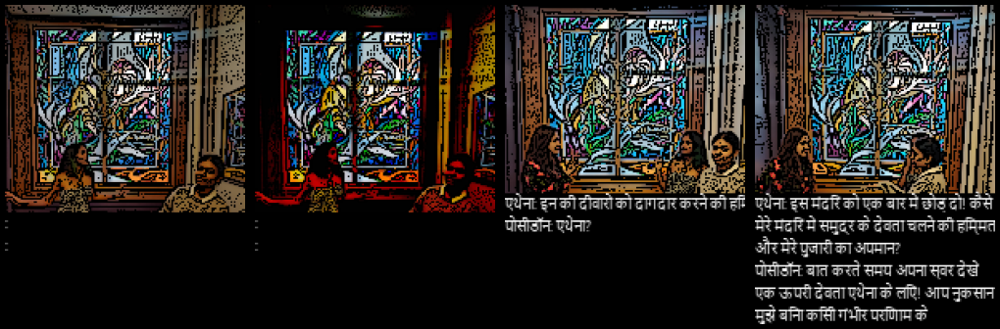

4
Scene3/d5.jpeg
Using font Nirmala...
Scene3/d6.jpeg
Using font Nirmala...
Scene3/d7.jpeg
Using font Nirmala...
Scene3/d8.jpeg
Using font Nirmala...


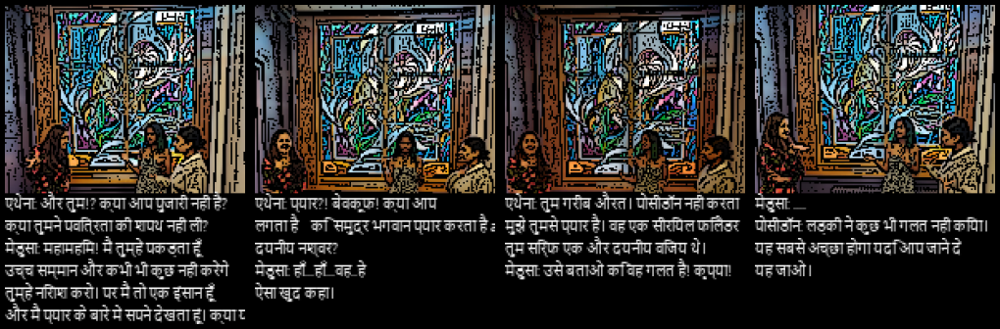

8
Scene3/d9.jpeg
Using font Nirmala...
Scene3/d10.jpeg
Using font Nirmala...
Scene3/d11.jpeg
Using font Nirmala...
Scene3/d12.jpeg
Using font Nirmala...


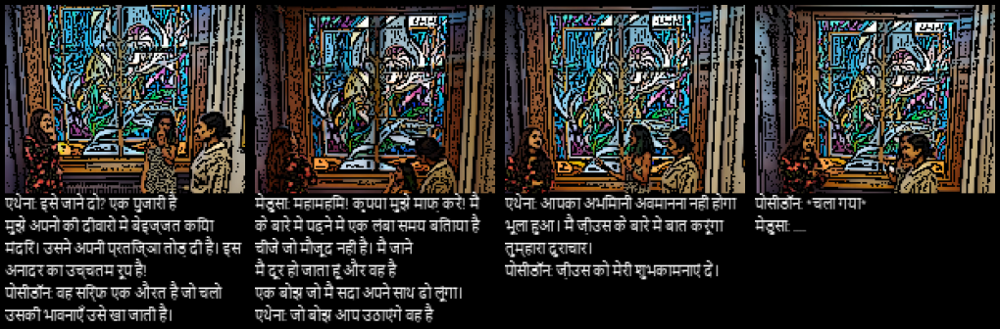

12
Scene3/d13.jpeg
Using font Nirmala...
Scene3/d14.jpeg
Using font Nirmala...
Scene3/d15.jpeg
Using font Nirmala...
Scene3/d16.jpeg
Using font Nirmala...


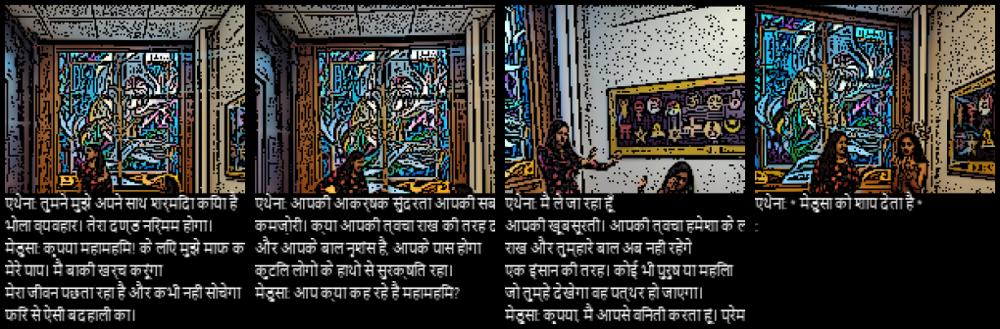

16
Scene3/d17.jpeg
Using font Nirmala...
Scene3/d18.jpeg
Using font Nirmala...
Scene3/d19.jpeg
Using font Nirmala...
Scene3/d20.jpeg
Using font Nirmala...


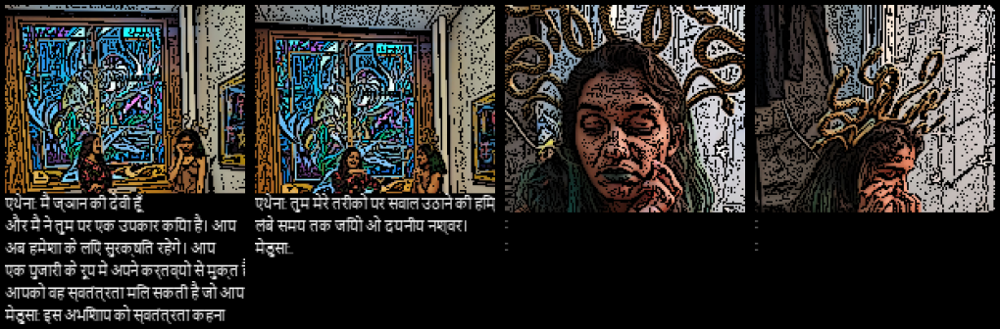

In [40]:
# scene 3 image generation

df = [d for d in data["Scene 3:"] if ':' in d]
generateimages('Scene3', df, 'Scene3/Scene3Strips/',6)

In [41]:
#Unicode

from PIL import Image, ImageDraw, ImageFont, ImageFilter

#configuration
font_size=36
width=6000
height=100
back_ground_color=(255,255,255)
font_size=36
font_color=(0,0,0)
unicode_text = [u":",
                u"मेडुसा वास्तव में डर गया था। उसने इतनी जल्दी नतीजे आने की उम्मीद नहीं की थी। केवल एक चीज जो वह कर सकती थी, वह थी पोसीडॉन के वचन पर भरोसा करना और आशा करना कि वह उसे बचा सकता है।",
                u"मेडुसा को विश्वास नहीं हो रहा था कि वह क्या सुन रही है। अपने इतिहास को जानने के बावजूद वह पोसीडॉन के लिए गिर गई थी। वह वास्तव में मूर्ख थी और उसके पास एथेना के क्रोध का सामना करने के अलावा और कोई चारा नहीं था।",
                u"मेडुसा की कोई उम्मीद नहीं बची थी। केवल एक चीज जो वह कर सकती थी वह थी एथेना से दया की भीख माँगना।",
                u"सबसे बुरा हुआ था। मेडुसा को उस दिन तक अपनी राक्षसीता के साथ रहना होगा जब तक वह मर नहीं जाती।"]

for i in range(0,5):
    im  =  Image.new ( "RGB", (width,height), back_ground_color )
    draw  =  ImageDraw.Draw ( im )
    unicode_font = ImageFont.truetype("Fonts/Nirmala.TTF", font_size)
    draw.text ( (10,10), unicode_text[i], font=unicode_font, fill=font_color )
    im.save("Scene3/hindi3_" + str(i+1) + ".jpg")

In [42]:
#scene 3 page generation 
from PIL import Image
from fpdf import FPDF


width = 2580
height = 3508


pdf.add_page()
pdf.set_font("times","",35)
pdf.set_fill_color(r=245,g=245,b=220)
#cover = Image.open('toons/jungle-book/_104680082_junglebook.jpg')
#width, height = cover.size


pdf.image("Scene3/hindi3_1.jpg",None,None,3500,100)
pdf.image("Scene3/Scene3Strips/s0.jpeg",None,None,2580,575)

pdf.image("Scene3/hindi3_2.jpg",None,None,3500,100)
pdf.image("Scene3/Scene3Strips/s4.jpeg",None,None,2580,575)

pdf.image("Scene3/hindi3_3.jpg",None,None,3500,100)
pdf.image("Scene3/Scene3Strips/s8.jpeg",None,None,2580,575)

pdf.image("Scene3/hindi3_4.jpg",None,None,3500,100)
pdf.image("Scene3/Scene3Strips/s12.jpeg",None,None,2580,575)

pdf.image("Scene3/hindi3_5.jpg",None,None,3500,100)
pdf.image("Scene3/Scene3Strips/s16.jpeg",None,None,2580,575)



print("done!")

done!


In [43]:
# Reading data for scene 4
import pandas as pd

data = pd.read_csv('Scene4/Scene4H.csv')
data.head(10)

,Scene 4:
0,मेडुसा अपने प्रियजनों को अपनी खतरनाक निगाहों स...
1,:
2,:
3,:
4,:
5,:
6,:
7,:
8,:
9,राज्य के लोग मेडुसा से डरने लगे। राजा ने मेडुस...


0
Scene4/d1.jpeg
Using font Nirmala...
Scene4/d2.jpeg
Using font Nirmala...
Scene4/d3.jpeg
Using font Nirmala...
Scene4/d4.jpeg
Using font Nirmala...


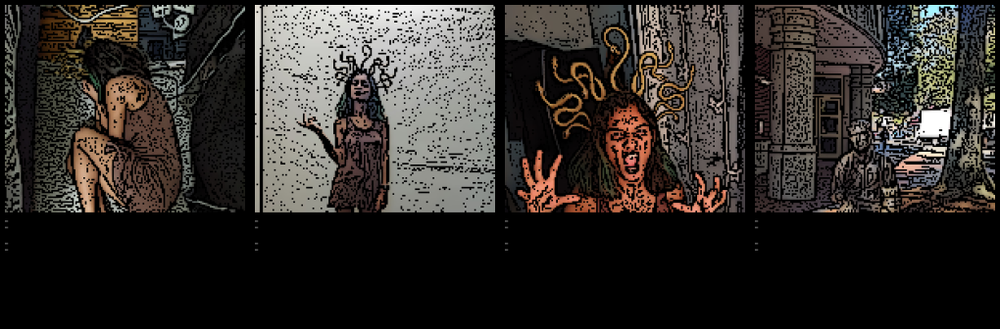

4
Scene4/d5.jpeg
Using font Nirmala...
Scene4/d6.jpeg
Using font Nirmala...
Scene4/d7.jpeg
Using font Nirmala...
Scene4/d8.jpeg
Using font Nirmala...


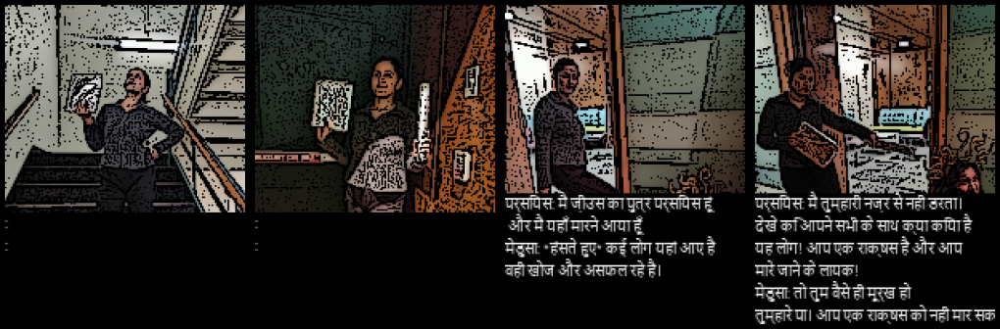

8
Scene4/d9.jpeg
Using font Nirmala...
Scene4/d10.jpeg
Using font Nirmala...
Scene4/d11.jpeg
Using font Nirmala...
Scene4/d12.jpeg
Using font Nirmala...


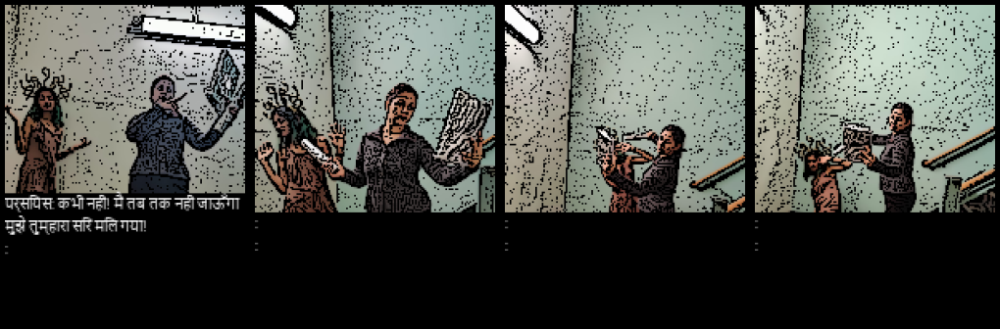

12
Scene4/d13.jpeg
Using font Nirmala...
Scene4/d14.jpeg
Using font Nirmala...
Scene4/d15.jpeg
Using font Nirmala...
Scene4/d16.jpeg
Using font Nirmala...


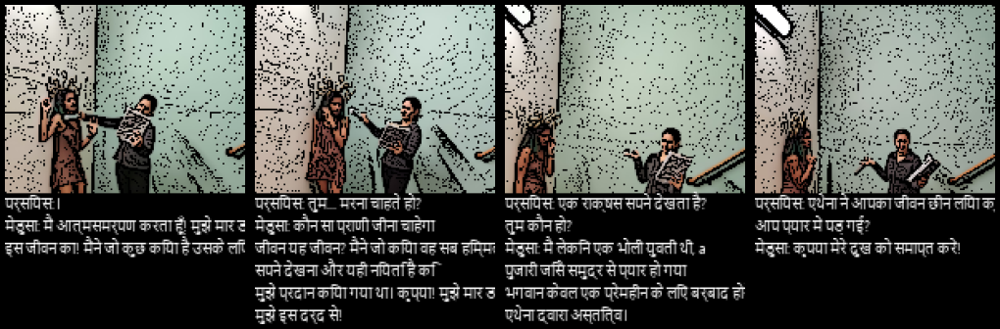

16
Scene4/d17.jpeg
Using font Nirmala...
Scene4/d18.jpeg
Using font Nirmala...
Scene4/d19.jpeg
Using font Nirmala...
Scene4/d20.jpeg
Using font Nirmala...


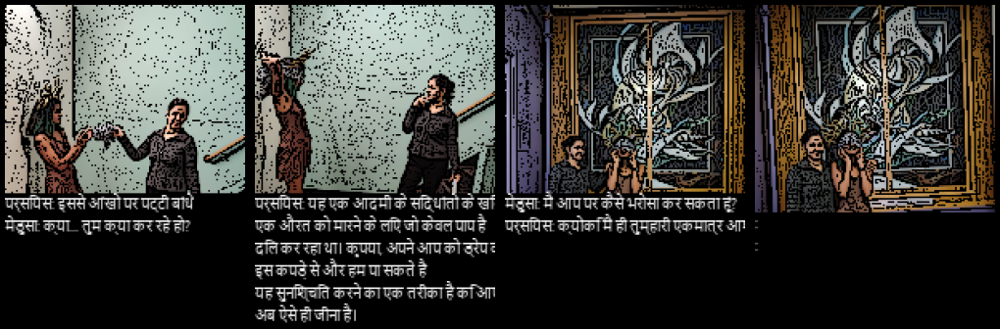

In [44]:
# scene 4 image generation

df = [d for d in data["Scene 4:"] if ':' in d]
generateimages('Scene4', df,'Scene4/Scene4Strips/',6)

In [45]:
#Unicode

from PIL import Image, ImageDraw, ImageFont, ImageFilter

#configuration
font_size=35
width=6000
height=150
back_ground_color=(255,255,255)
font_color=(0,0,0)
unicode_text = [u"मेडुसा अपने प्रियजनों को अपनी खतरनाक निगाहों से नहीं बचा सकी। उसने वह सब खो दिया जिसे वह कभी प्यार करती थी और एक बेरहम जीवन जीने के लिए बर्बाद हो गई थी। वह अंततः एक कड़वी महिला बन गई और जिसने भी उससे बात करने की कोशिश की उसे पत्थर में बदल दिया। वह एक अंधेरी गुफा में रहती थी, जिसमें लोगों की सभी मूर्तियाँ थीं जिन्हें उसने पत्थर में बदल दिया था।",
                u"राज्य के लोग मेडुसा से डरने लगे। राजा ने मेडुसा को हराने के लिए अपने कई आदमियों को भेजा लेकिन वे गुफा से कभी वापस नहीं आए। नगरवासियों को उनकी चिंता से बचाने के अपने अंतिम प्रयास में, राजा ने पर्सियस को भेजा, जो एक देवता था जो ज़ीउस का पुत्र था। पर्सियस को उनकी बहादुरी और बुद्धिमत्ता के लिए जाना \n जाता था। वह अकेला था जो मेडुसा को हराने के लिए काफी मजबूत हो सकता था। अगस्त में बरसात के दिन, पर्सियस ने ढाल और तलवार के साथ अपनी खोज शुरू की। उसने सावधानी से गुफा में प्रवेश किया, क्योंकि उसकी आँखों में एक नज़र उसके पेट फूलने की ओर ले जाएगी। गुफा के चारों ओर एक लंबी सैर के बाद, उसने \n आखिरकार उसे मूर्तियों के पास अपने से दूर सोते हुए पाया।",
                u"मेडुसा सही था। पर्सियस उसकी ओर देखे बिना उसका सिर नहीं काट पाएगा। वह कभी कायर नहीं होगा और राज्य में वापस चला जाएगा इसलिए उसका एकमात्र विकल्प कोशिश करते हुए मरना था। पर्सियस ने अपने भाग्य को लगभग स्वीकार कर लिया जब अचानक उसे पता चला कि वह अपनी ढाल में उसका प्रतिबिंब देख \n सकता है। वह उसकी ओर ही देख रही थी और वह अपनी ढाल के द्वारा उसे उसकी सारी महिमा में देख सकता था!",
                u"पर्सियस को एक राक्षस को मारने के लिए भेजा गया था, लेकिन उसकी जगह उसे संकट में एक युवती मिली। राक्षस को जानने के बाद वह उसे कैसे मार सकता था, वह सिर्फ एक दिल वाली महिला थी?",
                u"पर्सियस मेडुसा को वापस राज्य में ले गया और राजा और शहरवासियों को समझाया कि मेडुसा केवल एक गलत समझी गई महिला थी। जबकि मेडुसा को अपना विश्वास वापस जीतने में काफी समय लगा, वे उसके सांप के बाल और राख के चेहरे को देखने में सफल रहे।"]

for i in range(0,5):
    im  =  Image.new ( "RGB", (width,height), back_ground_color )
    draw  =  ImageDraw.Draw ( im )
    unicode_font = ImageFont.truetype("Fonts/Nirmala.TTF", font_size)
    draw.text ( (10,10), unicode_text[i], font=unicode_font, fill=font_color )
    im.save("Scene4/Hindi4P_" + str(i+1) + ".jpg")

# Creating PDF for page 4

In [46]:
#scene 4 page generation 
from PIL import Image
from fpdf import FPDF


width = 2580
height = 3508


pdf.add_page()
pdf.set_font("times","",35)
pdf.set_fill_color(r=245,g=245,b=220)
#cover = Image.open('toons/jungle-book/_104680082_junglebook.jpg')
#width, height = cover.size


pdf.image("Scene4/Hindi4P_1.jpg",None,None,2580,100)
pdf.image("Scene4/Scene4Strips/s0.jpeg",None,None,2580,575)

pdf.image("Scene4/Hindi4P_2.jpg",None,None,3500,100)
pdf.image("Scene4/Scene4Strips/s4.jpeg",None,None,2580,575)

pdf.image("Scene4/Hindi4P_3.jpg",None,None,3500,100)
pdf.image("Scene4/Scene4Strips/s8.jpeg",None,None,2580,575)

pdf.image("Scene4/Hindi4P_4.jpg",None,None,3500,100)
pdf.image("Scene4/Scene4Strips/s12.jpeg",None,None,2580,575)

pdf.image("Scene4/Hindi4P_5.jpg",None,None,3500,100)
pdf.image("Scene4/Scene4Strips/s16.jpeg",None,None,2580,575)


pdf.output("final_hindi.pdf", "F")
print("done!")

done!
